<a href="https://colab.research.google.com/github/gadirom/Colabs/blob/main/Neurall_Cellular_Automaton_for_Raph.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This is a Neural Cellular Automaton!

It was created exclusevely for the Creative Coding Chellange #WCCChallenge
organised by Raphaëlle Courville (https://twitter.com/sableraph)

The theme of the challenge was Raphaëlle himself!

Which is both exciting and quite challenging!
I had a feeling that in order for me to succeed in such a challenge I need to change my usual approach and dive in to a lesser known territories to explore the mystirious relm of self-organising virtual beings.

This Notebook consists of two parts.

- Demonstration of the pretrained automaton.
- The training code. (In case you whant to train it on another image. Be careful though, the training can take hours!)

To see the demonstration just run all the cells from the beginning including 'Results'. 

You may also try to apply the automaton to a grid which resolution differs from that on which the automaton was trained. For this run the cell "Try different resolution" and prepare to honk!

The code is mostly based on the tutorial by the great guru of Neural Cellular Aunomata, 
Alexander Mordvintsev: https://www.youtube.com/watch?v=8EN_8p9Toyc


In [ ]:
#@title Imports and Notebook Utilities
import os
import io
import PIL.Image, PIL.ImageDraw
import base64
import zipfile
import json
import requests
import numpy as np
import matplotlib.pylab as pl
import glob
from functools import partial

from IPython.display import Image, HTML, Markdown, clear_output
from tqdm.notebook import trange, tqdm


os.environ['FFMPEG_BINARY'] = 'ffmpeg'
import moviepy.editor as mvp
from moviepy.video.io.ffmpeg_writer import FFMPEG_VideoWriter


def imread(url, max_size=None, mode=None):
  if url.startswith(('http:', 'https:')):
    # wikimedia requires a user agent
    headers = {
      "User-Agent": "Requests in Colab/0.0 (https://colab.research.google.com/; no-reply@google.com) requests/0.0"
    }
    r = requests.get(url, headers=headers)
    f = io.BytesIO(r.content)
  else:
    f = url
  img = PIL.Image.open(f)
  if max_size is not None:
    img.thumbnail((max_size, max_size), PIL.Image.ANTIALIAS)
  if mode is not None:
    img = img.convert(mode)
  img = np.float32(img)/255.0
  return img

def np2pil(a):
  if a.dtype in [np.float32, np.float64]:
    a = np.uint8(np.clip(a, 0, 1)*255)
  return PIL.Image.fromarray(a)

def imwrite(f, a, fmt=None):
  a = np.asarray(a)
  if isinstance(f, str):
    fmt = f.rsplit('.', 1)[-1].lower()
    if fmt == 'jpg':
      fmt = 'jpeg'
    f = open(f, 'wb')
  np2pil(a).save(f, fmt, quality=95)

def imencode(a, fmt='jpeg'):
  a = np.asarray(a)
  if len(a.shape) == 3 and a.shape[-1] == 4:
    fmt = 'png'
  f = io.BytesIO()
  imwrite(f, a, fmt)
  return f.getvalue()

def im2url(a, fmt='jpeg'):
  encoded = imencode(a, fmt)
  base64_byte_string = base64.b64encode(encoded).decode('ascii')
  return 'data:image/' + fmt.upper() + ';base64,' + base64_byte_string

def imshow(a, fmt='jpeg', id=None):
  return display(Image(data=imencode(a, fmt)), display_id=id)

def grab_plot(close=True):
  """Return the current Matplotlib figure as an image"""
  fig = pl.gcf()
  fig.canvas.draw()
  img = np.array(fig.canvas.renderer._renderer)
  a = np.float32(img[..., 3:]/255.0)
  img = np.uint8(255*(1.0-a) + img[...,:3] * a)  # alpha
  if close:
    pl.close()
  return img

def tile2d(a, w=None):
  a = np.asarray(a)
  if w is None:
    w = int(np.ceil(np.sqrt(len(a))))
  th, tw = a.shape[1:3]
  pad = (w-len(a))%w
  a = np.pad(a, [(0, pad)]+[(0, 0)]*(a.ndim-1), 'constant')
  h = len(a)//w
  a = a.reshape([h, w]+list(a.shape[1:]))
  a = np.rollaxis(a, 2, 1).reshape([th*h, tw*w]+list(a.shape[4:]))
  return a

def zoom(img, scale=4):
  img = np.repeat(img, scale, 0)
  img = np.repeat(img, scale, 1)
  return img

class VideoWriter:
  def __init__(self, filename='_autoplay.mp4', fps=30.0, **kw):
    self.writer = None
    self.params = dict(filename=filename, fps=fps, **kw)

  def add(self, img):
    img = np.asarray(img)
    if self.writer is None:
      h, w = img.shape[:2]
      self.writer = FFMPEG_VideoWriter(size=(w, h), **self.params)
    if img.dtype in [np.float32, np.float64]:
      img = np.uint8(img.clip(0, 1)*255)
    if len(img.shape) == 2:
      img = np.repeat(img[..., None], 3, -1)
    self.writer.write_frame(img)

  def close(self):
    if self.writer:
      self.writer.close()

  def __enter__(self):
    return self

  def __exit__(self, *kw):
    self.close()
    if self.params['filename'] == '_autoplay.mp4':
      self.show()

  def show(self, **kw):
      self.close()
      fn = self.params['filename']
      display(mvp.ipython_display(fn, **kw))


class LoopWriter(VideoWriter):
  def __init__(self, *a, cross_len=1.0, **kw):
    super().__init__(*a, **kw)
    self._intro = []
    self._outro = []
    self.cross_len = int(cross_len*self.params['fps'])

  def add(self, img):
    if len(self._intro) < self.cross_len:
      self._intro.append(img)
      return
    self._outro.append(img)
    if len(self._outro) > self.cross_len:
      super().add(self._outro.pop(0))
  
  def close(self):
    for t in np.linspace(0, 1, len(self._intro)):
      img = self._intro.pop(0)*t + self._outro.pop(0)*(1.0-t)
      super().add(img)
    super().close()

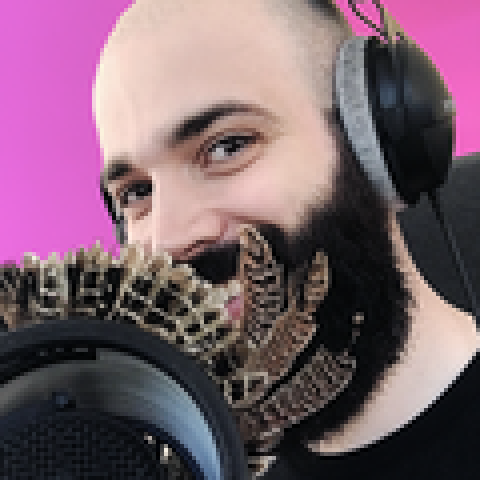

(120, 120, 4)


In [ ]:
#@title Load Target {vertical-output: true}
TARGET_EMOJI="🦎"
TARGET_SIZE=120

def load_image():
  #url='https://images.squarespace-cdn.com/content/v1/61ae498cca23ac5879391900/fa47c255-7b3f-4b19-9ba5-3bac0b1317d6/raphael.jpeg'
  url='https://d1fdloi71mui9q.cloudfront.net/2FDQy2urQfqD6vnRPi6R_qnKYgy5jmwOF52an'
  return imread(url, TARGET_SIZE)

def load_emoji(emoji):
  code = hex(ord(emoji))[2:].lower()
  url='https://raw.githubusercontent.com/googlefonts/noto-emoji/main/png/128/emoji_u{0}.png'.format(code)
  return imread(url, TARGET_SIZE)

def to_rgb(img):
  rgb, a = img[...,:3], img[...,3:4]
  #return 1.0-a+rgb
  return rgb

#target = load_emoji(TARGET_EMOJI)
target = load_image()
target[...,:3]*=target[...,3:]

#imshow(zoom(to_rgb(target)))
imshow(zoom(target))

print(target.shape)

In [ ]:
#@title Define the Seed {vertical-output: true}
CHN = 16
seed = np.zeros([1, TARGET_SIZE, TARGET_SIZE, CHN], np.float32)
seed[:, TARGET_SIZE//2, TARGET_SIZE//2, 3:] = 1.0

In [ ]:
#@title Automana definition {vertical-output: true}
import tensorflow as tf
from tensorflow.keras.layers import Conv2D

class CA(tf.Module):
  def __init__(self):
    self.model = tf.keras.Sequential([
        Conv2D(128, 3, padding='same', activation=tf.nn.relu),
        Conv2D(CHN, 1, kernel_initializer=tf.zeros)
    ])
  @tf.function
  def __call__(self, x):
    update_mask = tf.floor(tf.random.uniform(x[...,:1].shape)+0.5)
    return x+self.model(x)*update_mask

  def load(self, url):
    self.model.load_weights(url)
  def save(self, url):
    self.model.save_weights(url)

In [ ]:
#@title Load weights {vertical-output: true}
ca=CA()
#ca.load('/content/drive/MyDrive/ca_raph/ca_model')
ca.load('https://drive.google.com/uc?export=download&id=1s4L1nUICEySCZeb1sJFMOnJ0NQ9oRUCw')

ValueError: ignored

In [ ]:
#@title Results {vertical-output: true}

def run_ca(ca, x=seed, iter_n=100):
  with VideoWriter() as vid:
    for i in range(iter_n):
      vid.add(zoom(to_rgb(x[0])))
      x=ca(x)

run_ca(ca, iter_n=1000)

In [ ]:
#@title Try different resolution
x = np.zeros([1, 200, 200, CHN], np.float32)
x[:, 40, 40, 3:] = 1.0
run_ca(ca, x, iter_n=1000)

In [ ]:
#@title Train step {vertical-output: true}
ca = CA()

lr = tf.keras.optimizers.schedules.PiecewiseConstantDecay([1000], [1e-3, 3e-4])
trainer = tf.optimizers.Adam(lr)
loss_log = []

pool = np.repeat(seed, 256, 0)

@tf.function
def train_step(x):
  with tf.GradientTape() as g:
    #x=tf.repeat(seed, 4, 0)
    for i in range(100):
      x=ca(x)
      #print(target.shape)
      #print(x[...,:3].shape)
    target_loss = tf.reduce_mean(tf.square(x[...,:4]-target))
    #diff_loss = 0.0
    #for i in tf.range(50):
    #  prev_x=x
    #  x=ca(x)
    #  diff_loss+=tf.reduce_mean(tf.square(x-prev_x))
    loss = target_loss#+diff_loss
  params = ca.trainable_variables
  grads = g.gradient(loss, params)
  grads = [g/(tf.norm(g)+1e-8) for g in grads]
  trainer.apply_gradients(zip(grads, params))
  grad_norm = tf.add_n([tf.reduce_sum(g*g) for g in grads])**0.5
  return loss, x, grad_norm


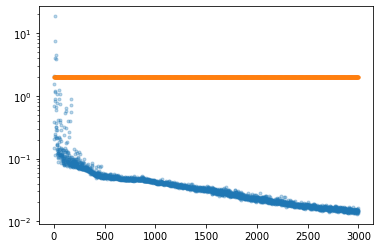

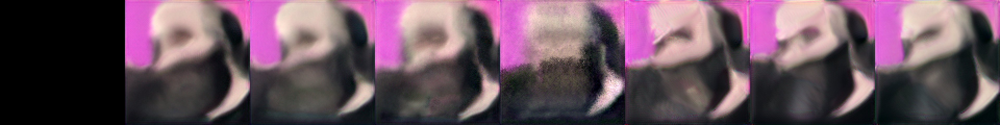

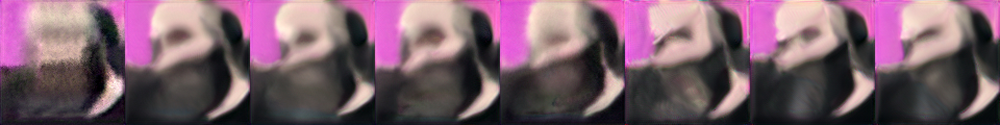

3000 0.014405367


In [ ]:
#@title Train loop {vertical-output: true}
from tensorflow.python.ops.gen_batch_ops import batch

for i in range(3001):
  batch_idx=np.random.choice(len(pool), 8, replace=False)
  x0 = pool[batch_idx]
  x0[:1]=seed
  loss, x, grad_norm = train_step(x0)
  pool[batch_idx]=x
  loss_log.append((loss.numpy(), grad_norm.numpy()))
  if i%500==0:
    clear_output(True)
    pl.plot(loss_log, '.', alpha=0.3)
    pl.yscale('log')
    pl.show()
    imshow(zoom(np.hstack(to_rgb(x0))))
    imshow(zoom(np.hstack(to_rgb(x))))
    print(i, loss.numpy())
    ca.save('/content/drive/MyDrive/ca_raph/ca_model')


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

ValueError: ignored

In [ ]:
#ca=CA()
ca.save('/content/drive/MyDrive/ca_raph/ca_model.h5')